# TOPIC MODELLING

In [ ]:
# Importation required
import matplotlib.pyplot as plt
import gensim
import gensim.corpora as corpora


from wordcloud import WordCloud
from gensim.corpora import Dictionary
from gensim.models import LdaModel
from gensim.models import CoherenceModel
from math import ceil


In [ ]:
# # Import necessary libraries
# from google.colab import drive # Uncomment this line if you are running this code on Google Colab
# from google.colab import files # Uncomment this line if you are running this code on Google Colab
import pandas as pd
import re
from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns
import os
import numpy as np
import matplotlib as mpl

In [ ]:
import pandas as pd
# file_path = '/content/'
file_path = '/content/drive/MyDrive/SMU TMLP/'

file_name = 'enron_clean_V3.csv'
# file_name = 'enron clean.xlsx'

try :
    df = pd.read_csv(file_name)
    # df = pd.read_excel(file_path + file_name)
    # df = pd.read_excel(file_name)
    print('File read into a pandas DataFrame')
    display(df.head())
    print(df.size)
except Exception as e:
    print('Error reading file: ', e)

# columns_to_drop = ['Body_lemma_dominant_topic',
#                    'Subject_lemma_dominant_topic']

# for col in columns_to_drop:
#     if col in df.columns:
#         df = df.drop(col, axis=1)

File read into a pandas DataFrame


,Year,Month,Day,Hour,Day_of_week,sentiment_score_compound,sentiment_score_positive,sentiment_score_neutral,sentiment_score_negative,Sender-Type,...,VBP,JJ,NNS,IN,DT,CC,JJS,WP,NN,JJR
0,2000,11,16,17,3,0.9616,0.226,0.708,0.066,0,...,8,8,1,12,8,2,1,1,13,0
1,2000,12,8,13,4,0.5940,0.074,0.926,0.000,0,...,5,8,3,3,4,2,0,0,15,1
2,2001,5,15,16,1,-0.3923,0.036,0.918,0.045,0,...,4,6,10,9,9,1,0,1,26,0
3,2000,12,12,7,1,-0.4767,0.000,0.829,0.171,0,...,0,2,0,1,0,0,0,0,10,0
4,2001,5,15,6,1,-0.0772,0.058,0.893,0.050,0,...,5,14,17,23,16,11,0,0,19,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
433069,2001,9,21,18,4,0.0000,0.000,1.000,0.000,1,...,0,1,0,0,0,0,0,0,1,0
433070,2001,9,4,15,1,0.0000,0.000,1.000,0.000,1,...,1,1,3,2,2,2,0,0,3,0
433071,2001,11,5,9,0,0.9758,0.118,0.851,0.031,1,...,17,18,20,23,19,10,0,0,21,3
433072,2001,10,17,23,2,0.9658,0.067,0.905,0.028,1,...,6,14,12,57,63,22,1,0,61,0


23385996


In [ ]:
df.columns

Index(['Year', 'Month', 'Day', 'Hour', 'Day_of_week',
       'sentiment_score_compound', 'sentiment_score_positive',
       'sentiment_score_neutral', 'sentiment_score_negative', 'Sender-Type',
       'Unique-Mails-From-Sender', 'Contains-Reply-Forwards', 'Subject_lemma',
       'Body_lemma', 'Subject_num_sentences', 'Subject_median_chars_per_word',
       'Subject_median_words_per_sentence', 'Subject_uppercase_ratio',
       'Subject_punctuation_ratio', 'Subject_typo_ratio',
       'Subject_special_chars_ratio', 'Body_num_sentences',
       'Body_median_chars_per_word', 'Body_median_words_per_sentence',
       'Body_uppercase_ratio', 'Body_punctuation_ratio', 'Body_typo_ratio',
       'Body_special_chars_ratio', 'Bcc_count', 'Label',
       'Body_lexical_complexity', 'Body_lemma_dominant_topic',
       'Subject_lemma_dominant_topic', 'VBZ', 'VBD', 'CD', 'PRP', 'VB', 'VBN',
       'RB', 'TO', 'RP', 'VBG', 'NNP', 'VBP', 'JJ', 'NNS', 'IN', 'DT', 'CC',
       'JJS', 'WP', 'NN', 'JJR'],
  

In [ ]:
## Get all the unstructured data together as a dataframe
text_columns = ['Body', 'Subject']

# Create a new DataFrame that contains only the columns with unstructured text
unstructured_text_df = df[text_columns].copy()
unstructured_text_df.head()

,Body,Subject
0,status john really sure happen us impression v...,status
1,summer inverse suckhope make money natgas last...,summer inverse
2,wti bullet swap contract hi follow email recei...,wti bullet swap contract
3,fwd nytimescom article suspend rabbi quits sem...,fwd nytimescom article suspend rabbi quits sem...
4,daily chart matrix hot link information contai...,daily chart matrix hot link


In [ ]:
!pip install nltk
!pip install contractions

  Obtaining dependency information for contractions from https://files.pythonhosted.org/packages/bb/e4/725241b788963b460ce0118bfd5c505dd3d1bdd020ee740f9f39044ed4a7/contractions-0.1.73-py2.py3-none-any.whl.metadata
  Obtaining dependency information for textsearch>=0.0.21 from https://files.pythonhosted.org/packages/e2/0f/6f08dd89e9d71380a369b1f5b6c97a32d62fc9cfacc1c5b8329505b9e495/textsearch-0.0.24-py2.py3-none-any.whl.metadata
  Obtaining dependency information for anyascii from https://files.pythonhosted.org/packages/4f/7b/a9a747e0632271d855da379532b05a62c58e979813814a57fa3b3afeb3a4/anyascii-0.3.2-py3-none-any.whl.metadata
  Obtaining dependency information for pyahocorasick from https://files.pythonhosted.org/packages/36/76/d83c60ec7a202cbfeffaa9649d0fee6ddcb974622e411b86211ff3572549/pyahocorasick-2.1.0-cp311-cp311-win_amd64.whl.metadata
   ---------------------------------------- 0.0/289.9 kB ? eta -:--:--
   ---------------------------------------  286.7/289.9 kB 8.9 MB/s eta 0:00

In [ ]:
import re
import nltk
import contractions
from nltk import pos_tag
from nltk.corpus import wordnet
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [ ]:
nltk.download('averaged_perceptron_tagger')
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package punkt to C:\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to C:\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to C:\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
# Function to map NLTK's POS tags to the format wordnet lemmatizer would accept
def get_wordnet_pos(word):
    """Map POS tag to first character lemmatize() accepts"""
    tag = pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ,
                "N": wordnet.NOUN,
                "V": wordnet.VERB,
                "R": wordnet.ADV}
    return tag_dict.get(tag, wordnet.NOUN)

# Function to lemmatize text based on POS tagging
def lemmatize_text(text):
    lemmatizer = WordNetLemmatizer()
    tokens = word_tokenize(text)
    lemmatized_tokens = [lemmatizer.lemmatize(token, get_wordnet_pos(token)) for token in tokens]
    return ' '.join(lemmatized_tokens)

# Function to remove special characters
def remove_special_characters(text, remove_digits=False):
    pattern = r'[^a-zA-Z0-9\s]' if not remove_digits else r'[^a-zA-Z\s]'
    text = re.sub(pattern, '', text)
    return text

# Function to remove stopwords
def remove_stopwords(text, is_lower_case=False):
    stop_words = set(stopwords.words('english'))
    tokens = word_tokenize(text)
    tokens = [token.strip() for token in tokens]
    if is_lower_case:
        filtered_tokens = [token for token in tokens if token not in stop_words]
    else:
        filtered_tokens = [token for token in tokens if token.lower() not in stop_words]
    return ' '.join(filtered_tokens)

# Main function to normalize corpus
def normalize_corpus(corpus, text_lower_case=True, text_lemmatization=True,
                     special_char_removal=True, stopword_removal=True,
                     remove_digits=True, expand_contractions=True):
    normalized_corpus = []
    for doc in corpus:
        doc = str(doc)
        # Expand contractions
        if expand_contractions:
            doc = contractions.fix(doc)
        # Convert to lowercase
        if text_lower_case:
            doc = doc.lower()
        # Replace newlines and such with spaces
        doc = re.sub(r'[\r|\n|\r\n]+', ' ', doc)
        # Lemmatize text
        if text_lemmatization:
            doc = lemmatize_text(doc)
        # Remove special characters and/or digits
        if special_char_removal:
            doc = remove_special_characters(doc, remove_digits=remove_digits)
        # Ensure single spaces between words
        doc = re.sub(' +', ' ', doc)
        # Remove stopwords
        if stopword_removal:
            doc = remove_stopwords(doc, is_lower_case=text_lower_case)
        normalized_corpus.append(doc)
    return normalized_corpus

# Example of normalizing a single column dataframe
def normalize_corpus_df(df, columns):
    processed_df = pd.DataFrame()
    for column in columns:
        processed_column_name = f'{column}'
        processed_df[processed_column_name] = df[column].apply(lambda x: normalize_corpus([x])[0] if pd.notnull(x) else x)
    return processed_df

# # Convert integer values to strings in the specified columns
# for column in text_columns:
#     unstructured_text_df[column] = unstructured_text_df[column].astype(str)

# Now you can call normalize_corpus_df without getting an error
processed_text_df = normalize_corpus_df(unstructured_text_df, text_columns)
processed_text_df.head()

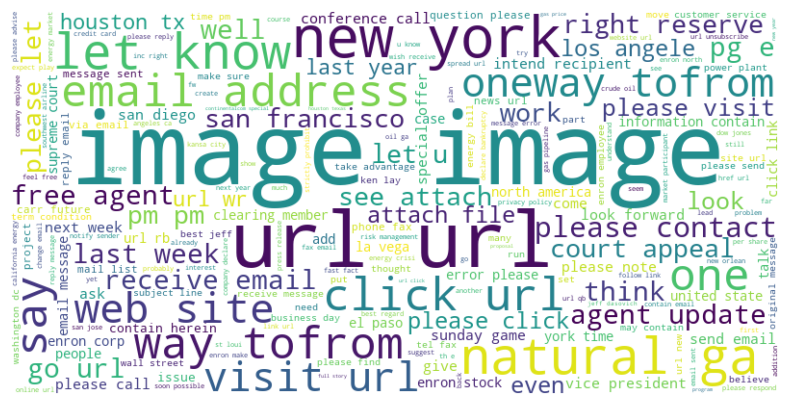

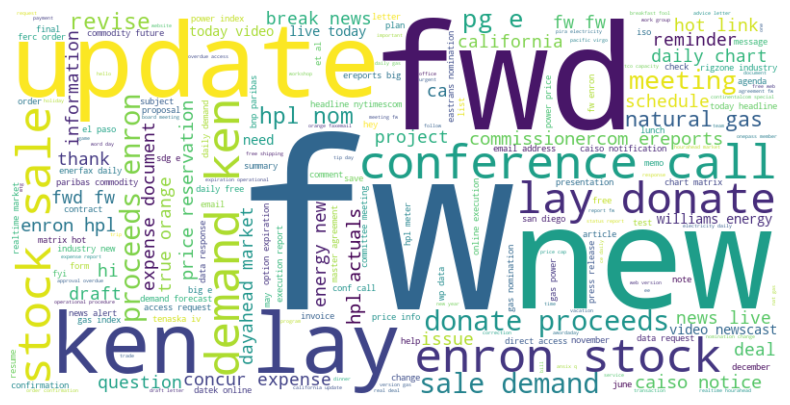

In [ ]:
briefly_df2 = processed_text_df.copy()

for col in text_columns:
    text_combined = " ".join(briefly_df2[col].dropna())

    wordcloud = WordCloud(width=800, height=400, background_color ='white').generate(text_combined)
    # Display the generated WordCloud
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

    briefly_df2[col + 'Tokenised'] = briefly_df2[col].apply(lambda x: x.split() if isinstance(x, str) else [])

In [ ]:
briefly_df2.head()

,Body,Subject,BodyTokenised,SubjectTokenised
0,status john really sure happen us impression v...,status,"[status, john, really, sure, happen, us, impre...",[status]
1,summer inverse suckhope make money natgas last...,summer inverse,"[summer, inverse, suckhope, make, money, natga...","[summer, inverse]"
2,wti bullet swap contract hi follow email recei...,wti bullet swap contract,"[wti, bullet, swap, contract, hi, follow, emai...","[wti, bullet, swap, contract]"
3,fwd nytimescom article suspend rabbi quits sem...,fwd nytimescom article suspend rabbi quits sem...,"[fwd, nytimescom, article, suspend, rabbi, qui...","[fwd, nytimescom, article, suspend, rabbi, qui..."
4,daily chart matrix hot link information contai...,daily chart matrix hot link,"[daily, chart, matrix, hot, link, information,...","[daily, chart, matrix, hot, link]"


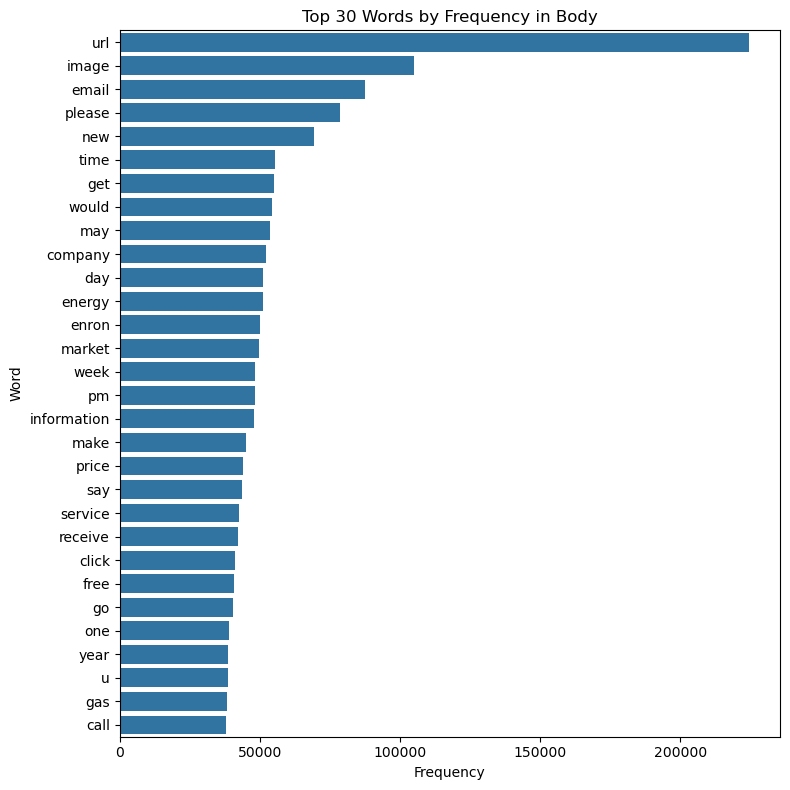

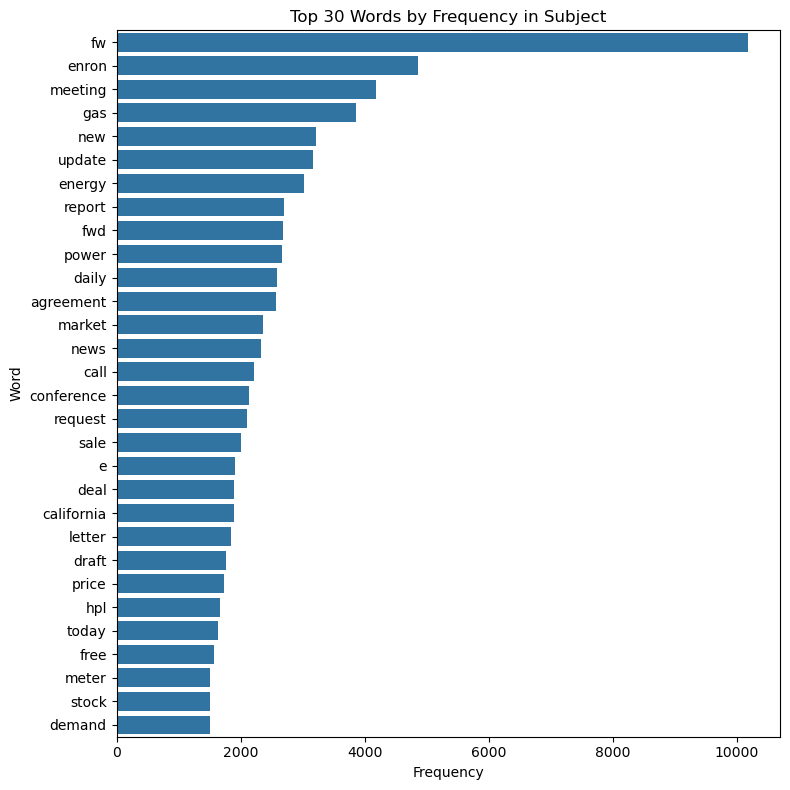

In [ ]:
for col in text_columns:
  # Aggregate tokens into a single list
  new_tokens = []
  for tokens in briefly_df2[col+'Tokenised'].tolist():
      new_tokens += tokens

  # Count the frequency of each word
  counted_words = Counter(new_tokens)

  # Create a DataFrame from the counted words
  word_frequency = pd.DataFrame(counted_words.items(), columns=['word', 'frequency']).sort_values(by="frequency", ascending=False)

  # Generate the frequency chart for the top 30 words
  plt.figure(figsize=(8, 8))
  sns.barplot(x='frequency', y='word', data=word_frequency.head(30))
  plt.title(f'Top 30 Words by Frequency in {col[:20]}')
  plt.xlabel('Frequency')
  plt.ylabel('Word')
  plt.tight_layout()
  plt.show()


In [ ]:
# df_lab = df[['Label']].iloc[:132999] ## DELETE THIS LINE

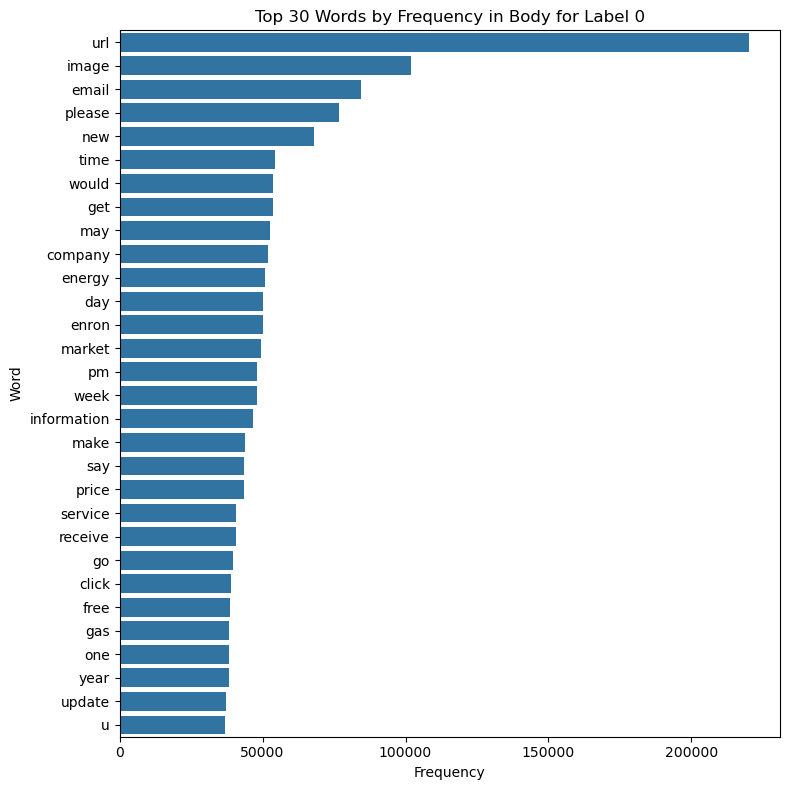

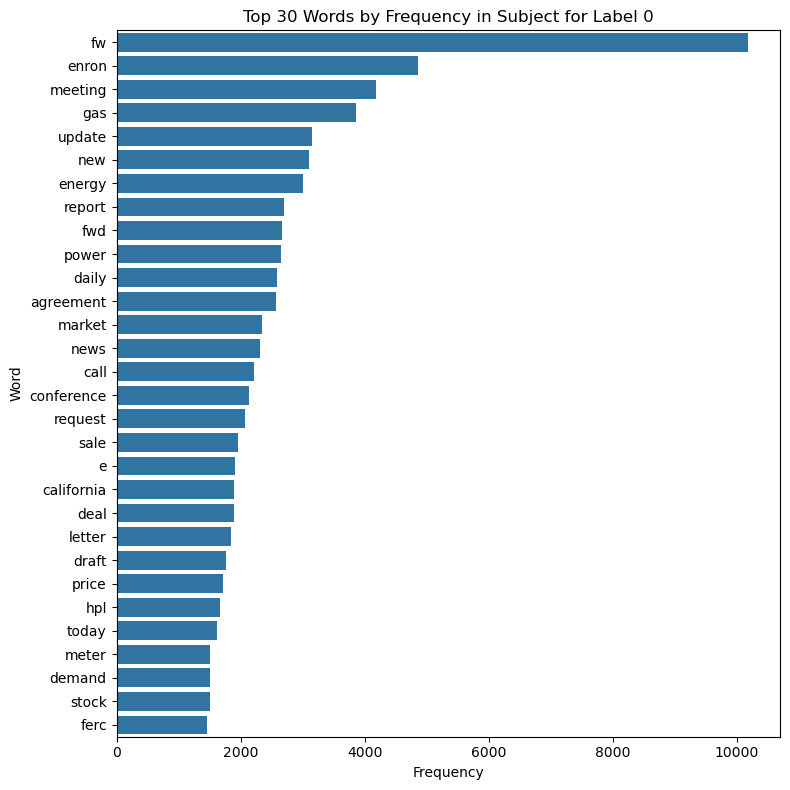

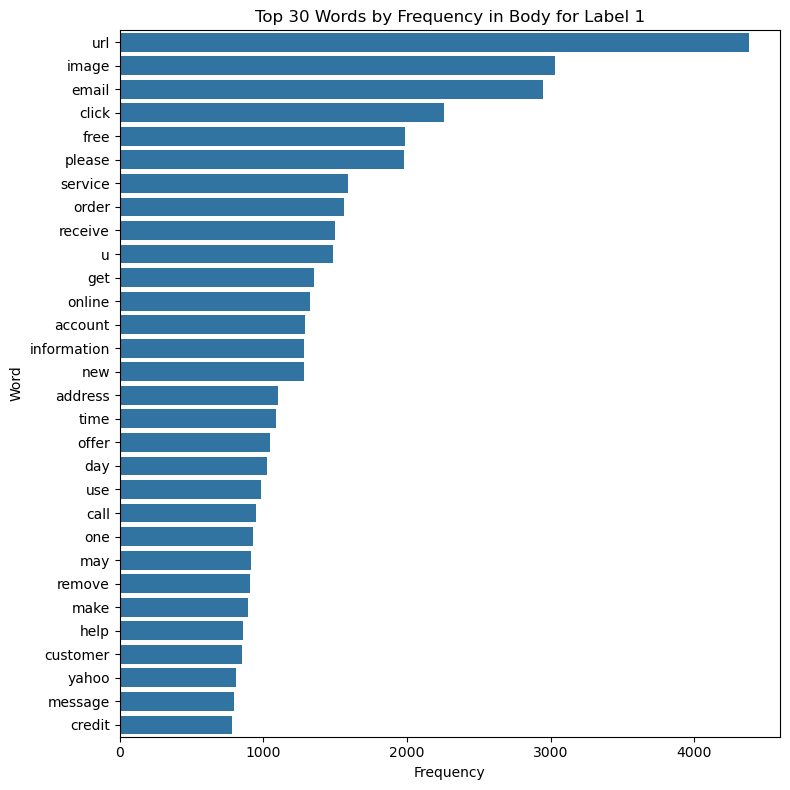

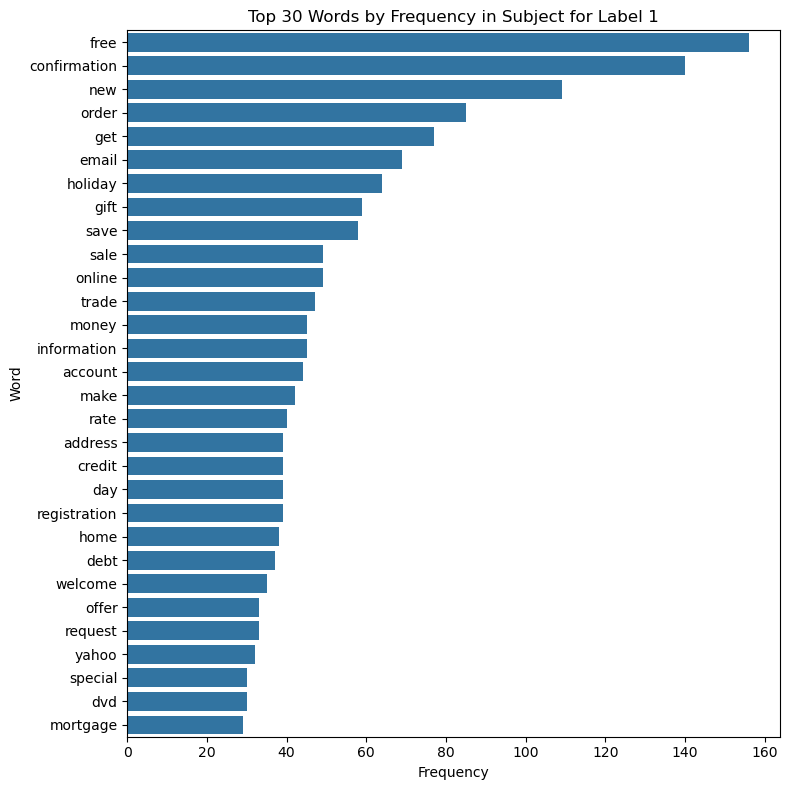

In [ ]:
# Add 'Label' column from df_lab to briefly_df2
briefly_df2['Label'] = df_lab['Label']

for label in briefly_df2['Label'].unique():
    df_label = briefly_df2[briefly_df2['Label'] == label]

    for col in text_columns:
        # Aggregate tokens into a single list
        new_tokens = []
        for tokens in df_label[col+'Tokenised'].tolist():
            new_tokens += tokens

        # Count the frequency of each word
        counted_words = Counter(new_tokens)

        # Create a DataFrame from the counted words
        word_frequency = pd.DataFrame(counted_words.items(), columns=['word', 'frequency']).sort_values(by="frequency", ascending=False)

        # Generate the frequency chart for the top 30 words
        plt.figure(figsize=(8, 8))
        sns.barplot(x='frequency', y='word', data=word_frequency.head(30))
        plt.title(f'Top 30 Words by Frequency in {col[:20]} for Label {label}')
        plt.xlabel('Frequency')
        plt.ylabel('Word')
        plt.tight_layout()
        plt.show()

Processing column: Body

Topic number: 2
Coherence Score: 0.3992203577103056
Perplexity Score: -8.349735538218914

Topic number: 3
Coherence Score: 0.3978474635252161
Perplexity Score: -8.235658370036699

Topic number: 4
Coherence Score: 0.48150734535696266
Perplexity Score: -8.172119517801079

Topic number: 5
Coherence Score: 0.4703080974223088
Perplexity Score: -8.166952336706952

Topic number: 6
Coherence Score: 0.503613912713707
Perplexity Score: -8.14511747872644

Topic number: 7
Coherence Score: 0.5359763301741846
Perplexity Score: -8.16557470578545

Topic number: 8
Coherence Score: 0.5230078675332257
Perplexity Score: -8.228003261672747

Topic number: 9
Coherence Score: 0.5049294267452117
Perplexity Score: -8.36028145020745

Topic number: 10
Coherence Score: 0.5284804641459508
Perplexity Score: -8.528798223410565

Topic number: 11
Coherence Score: 0.5179484454573727
Perplexity Score: -8.674121825978434

Topic number: 12
Coherence Score: 0.5335714247551295
Perplexity Score: -8.81

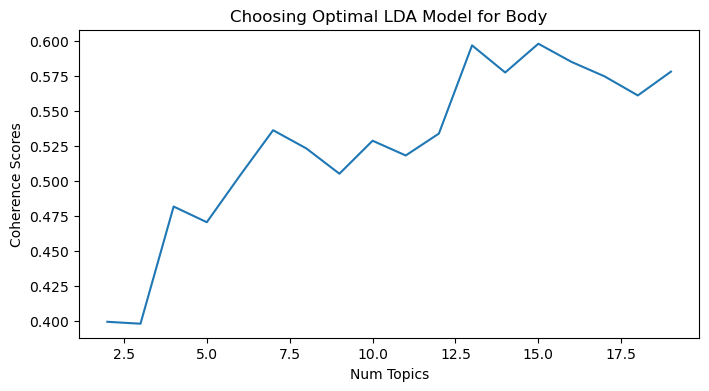

Processing column: Subject

Topic number: 2
Coherence Score: 0.29540632930906496
Perplexity Score: -7.92120849823818

Topic number: 3
Coherence Score: 0.33926402479634515
Perplexity Score: -7.984135916318483

Topic number: 4
Coherence Score: 0.28439371530361296
Perplexity Score: -8.050272812206675

Topic number: 5
Coherence Score: 0.31025860653658305
Perplexity Score: -8.090505682282112

Topic number: 6
Coherence Score: 0.32281481080705565
Perplexity Score: -8.143763376440951

Topic number: 7
Coherence Score: 0.4001331384777535
Perplexity Score: -8.2069987372802

Topic number: 8
Coherence Score: 0.36702077291306145
Perplexity Score: -8.249489586426765

Topic number: 9
Coherence Score: 0.41071609642542206
Perplexity Score: -8.361638954161862

Topic number: 10
Coherence Score: 0.44220670867320644
Perplexity Score: -8.63939627915349

Topic number: 11
Coherence Score: 0.43965421235349017
Perplexity Score: -9.080862216831123

Topic number: 12
Coherence Score: 0.44846123027175283
Perplexity 

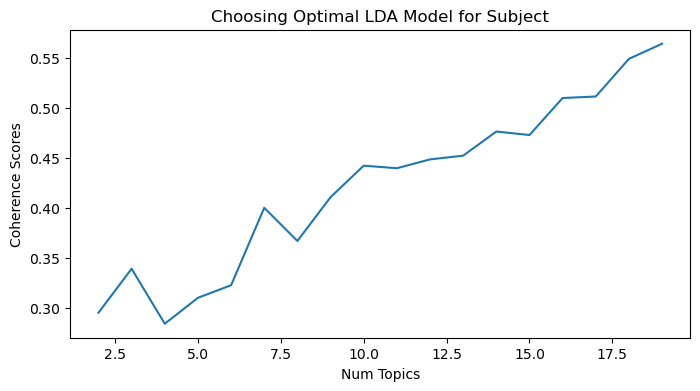

In [ ]:
import gensim
from gensim.models import CoherenceModel
from gensim.corpora import Dictionary
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
import contractions
import string
import numpy as np

def compute_evaluation_values(corpus, dictionary, k, texts):
    lda_model = gensim.models.LdaMulticore(corpus=corpus,
                                           id2word=dictionary,
                                           num_topics=k,
                                           random_state=100,
                                           chunksize=100,
                                           passes=20,
                                           per_word_topics=True)

    coherence_model_lda = CoherenceModel(model=lda_model, texts=texts, dictionary=dictionary, coherence='c_v')
    perplexity = lda_model.log_perplexity(corpus)

    return [coherence_model_lda.get_coherence(), perplexity, lda_model]

for col in text_columns:
    print(f"Processing column: {col}\n")

    # Create Dictionary
    id2word = corpora.Dictionary(briefly_df2[col+'Tokenised'])

    # Filter out tokens that appear in only 1 documents and appear in more than 90% of the documents
    id2word.filter_extremes(no_below=2, no_above=0.9)

    # Create Corpus
    texts = briefly_df2[col+'Tokenised']

    # Term Document Frequency
    corpus = [id2word.doc2bow(text) for text in texts]

    topic_param = []
    coherence_score = []
    perplexity_score = []

    for k in range(2, 20):  # Experiment with a range of topics
        print('Topic number:', k)
        ev, perplexity, lda_model = compute_evaluation_values(corpus=corpus, dictionary=id2word, k=k, texts=texts)
        coherence_score.append(ev)
        perplexity_score.append(perplexity)
        topic_param.append(k)  # Append the number of topics to topic_param
        print('Coherence Score:', ev)
        print('Perplexity Score:', perplexity)
        print()

    # Show graph
    plt.figure(figsize=(8,4))
    plt.plot(topic_param, coherence_score)

    plt.title(f"Choosing Optimal LDA Model for {col[:20]}")
    plt.xlabel("Num Topics")
    plt.ylabel("Coherence Scores")
    plt.show()
    # We choose the highest coherence score reached before a major drop. K = 14

In [ ]:
# import warnings
# warnings.simplefilter("ignore", DeprecationWarning)
# from sklearn.feature_extraction.text import TfidfVectorizer
# from sklearn.decomposition import LatentDirichletAllocation as LDA
# import numpy as np
# from joblib import dump
# from nltk.stem import WordNetLemmatizer
# from nltk.tokenize import word_tokenize
# import nltk
# import string

# # Helper function
# def print_topics(model, vectorizer, n_top_words):
#     words = vectorizer.get_feature_names_out()
#     for topic_idx, topic in enumerate(model.components_):
#         print("\nTopic #%d:" % topic_idx)
#         print(" ".join([words[i]
#                         for i in topic.argsort()[:-n_top_words - 1:-1]]))

# np.random.seed(0)

# # Tweak the two parameters below (use int values below 15)
# number_topics = 12
# number_words = 25

# # Initialize lemmatizer
# lemmatizer = WordNetLemmatizer()

# # # import contractions
# # # def tokenize_and_lemmatize(text):
# # #     return [lemmatizer.lemmatize(word) for word in word_tokenize(contractions.fix(text.translate(str.maketrans('', '', string.punctuation))))]

# # # # Use tf-idf features, remove contractions and punctuation
# # # tfidf_vectorizer = TfidfVectorizer(max_df=0.95, min_df=2, stop_words='english', tokenizer=tokenize_and_lemmatize)

# # # for col in ['briefly describe what you think the industry as a whole and/or employers could do to improve mental health support for employees.']:
# # #     print(f"Processing column: {col}")
# # #     tfidf_data = tfidf_vectorizer.fit_transform(df[col])

# # #     # Create and fit the LDA model
# # #     lda = LDA(n_components=number_topics)
# # #     lda.fit(tfidf_data)

# # #     # Print the topics found by the LDA model
# # #     print(f"Topics found via LDA for column {col}:")
# # #     print_topics(lda, tfidf_vectorizer, number_words)
# # #     print()

# # #     # Get the dominant topic for each document
# # #     topic_weights = lda.transform(tfidf_data)
# # #     dominant_topic = np.argmax(topic_weights, axis=1)

# # #     # Insert the dominant topic as a new column
# # #     df.insert(df.columns.get_loc(col) + 1, col + '_dominant_topic', dominant_topic)

# # #     # # Save the model
# # #     # dump(lda, col+'lda_model.joblib')
# # #     dump(lda, 'briefly describe what you think the industry as a whole_lda_model.joblib')

# # Use tf-idf features
# tfidf_vectorizer = TfidfVectorizer(max_df=0.95, min_df=2, stop_words='english')

# for col in ['Body_lemma', 'Subject_lemma']:
#     print(f"Processing column: {col}")
#     tfidf_data = tfidf_vectorizer.fit_transform(df[col])

#     # Create and fit the LDA model
#     lda = LDA(n_components=number_topics)
#     lda.fit(tfidf_data)

#     # Print the topics found by the LDA model
#     print(f"Topics found via LDA for column {col}:")
#     print_topics(lda, tfidf_vectorizer, number_words)
#     print()

#     # Get the dominant topic for each document
#     topic_weights = lda.transform(tfidf_data)
#     dominant_topic = np.argmax(topic_weights, axis=1)

#     # Insert the dominant topic as a new column
#     df.insert(df.columns.get_loc(col) + 1, col + '_dominant_topic', dominant_topic)

#     # Save the model
#     dump(lda, col + '_lda_model.joblib')

Processing column: Body_lemma
Topics found via LDA for column Body_lemma:

Topic #0:
hourahead schedule final variance hour message detect start date 01 file txt schedules westdesk iso ancillary parse scheduling portland log award california intend contain codesite

Topic #1:
thank know enron expense employee good work think report let just make john resume need want talk fw help pay look million company like chris

Topic #2:
com 2001 report 782 notification 415 enron aol 10 3d url 11 mara website publish fw cheryl view mail available marie trv 12 nelson order

Topic #3:
url image com just good time know new free day think email like click 20 week game mail want great year work make 09 say

Topic #4:
agreement request thank gas attach need contract enron change know let deal credit review question draft transaction power list report master product send trade ena

Topic #5:
vince feedback mail maggi mike thank 713 pep request prc enron fw com performance 853 process list contact employe

In [ ]:
# df.to_csv('enron clean reduced temp 2.csv', index=False)

file_path = '/content/drive/My Drive/SMU TMLP/'
file_name = 'enron clean reduced temp2.csv'

# Combine the file path and file name
full_path = file_path + file_name

# Save the DataFrame to the CSV file
df.to_csv(full_path, index=False)

In [ ]:
df.columns

Index(['Year', 'Month', 'Day', 'Hour', 'Day_of_week',
       'sentiment_score_compound', 'sentiment_score_positive',
       'sentiment_score_neutral', 'sentiment_score_negative', 'Sender-Type',
       'Unique-Mails-From-Sender', 'Contains-Reply-Forwards', 'Subject_lemma',
       'Subject_lemma_dominant_topic', 'Subject_lemma_doc2vec_features',
       'Body_lemma', 'Body_lemma_dominant_topic', 'Subject_num_words',
       'Subject_num_sentences', 'Subject_median_chars_per_word',
       'Subject_median_words_per_sentence', 'Subject_uppercase_ratio',
       'Subject_punctuation_ratio', 'Subject_typo_ratio',
       'Subject_special_chars_ratio', 'Body_num_words', 'Body_num_sentences',
       'Body_median_chars_per_word', 'Body_median_words_per_sentence',
       'Body_uppercase_ratio', 'Body_punctuation_ratio', 'Body_typo_ratio',
       'Body_special_chars_ratio', 'Bcc_count', 'Label'],
      dtype='object')

# UNUSED TEXT DATA

### Text Data Preprocessing (Non Fraud)

In this preprocessing pipeline, we will perform several steps to clean and prepare text data for analysis or modeling. Each step is aimed at removing noise and irrelevant information from the text, making it suitable for further processing. Here are the details of each step:

- Decontracted: Expand contracted words like "can't" to "cannot", "won't" to "will not", etc.
- Remove Numbers: Eliminate numerical digits from the text.
- Remove HTML: Strip HTML tags from the text, if present.
- Remove URL: Remove any URLs or hyperlinks from the text.
- Remove Punctuations: Exclude punctuation marks such as commas, periods, exclamation marks, etc.
- Remove Patterns: Delete any specific patterns or regular expressions from the text.
- Remove Stopwords: Eliminate common stopwords (e.g., "the", "is", "and") from the text.
- After applying these preprocessing steps, the text data will be cleaned and ready for further analysis, such as text mining, sentiment analysis, or topic modeling.

In [ ]:
# # Filter the dataframe for fraud emails (label = 1)
# fraud_df = dataframe[dataframe['Label'] == 1]

# # Display the first few rows of the fraud dataframe
# fraud_df.head(10)

# Filter the dataframe for fraud emails (label = 1)
non_fraud_df = dataframe[dataframe['Label'] == 0]

# Display the first few rows of the non fraud dataframe
non_fraud_df.head(10)

,Folder-Name,Date,From,To,Subject,X-From,X-To,X-cc,X-bcc,X-Origin,Body,Cc,Bcc,Suspicious-Folders,Sender-Type,Unique-Mails-From-Sender,Low-Comm,Contains-Reply-Forwards,Label
0,arnold-j,"Thu, 16 Nov 2000 09:30:00 -0800 (PST)",msagel@home.com,jarnold@enron.com,Status,"""Mark Sagel"" <msagel@home.com>","""John Arnold"" <jarnold@enron.com>",,,Arnold-J,Status John: I'm not really sure what happened...,,,FALSE,External,18,FALSE,FALSE,0.0
1,arnold-j,"Fri, 8 Dec 2000 05:05:00 -0800 (PST)",slafontaine@globalp.com,john.arnold@enron.com,re:summer inverses,slafontaine@globalp.com,John.Arnold@enron.com,,,Arnold-J,re:summer inverses i suck-hope youve made more...,,,FALSE,External,4,TRUE,FALSE,0.0
2,arnold-j,"Tue, 15 May 2001 09:43:00 -0700 (PDT)",iceoperations@intcx.com,"icehelpdesk@intcx.com, internalmarketing@intcx...",The WTI Bullet swap contracts,ICE Operations <ICEOperations@intcx.com>,"**ICEHELPDESK <**ICEHELPDESK@intcx.com>, **Int...",,,Arnold-J,"The WTI Bullet swap contracts Hi, Following th...",,,FALSE,External,3,TRUE,FALSE,0.0
3,arnold-j,"Mon, 11 Dec 2000 23:52:00 -0800 (PST)",klarnold@flash.net,john.arnold@enron.com,Fwd: NYTimes.com Article: Suspended Rabbi Quit...,Karen Arnold <klarnold@flash.net>,john.arnold@enron.com,,,Arnold-J,Fwd: NYTimes.com Article: Suspended Rabbi Quit...,,,FALSE,External,9,FALSE,TRUE,0.0
4,arnold-j,"Mon, 14 May 2001 23:59:00 -0700 (PDT)",soblander@carrfut.com,soblander@carrfut.com,daily charts and matrices as hot links 5/15,SOblander@carrfut.com,soblander@carrfut.com,,,Arnold-J,daily charts and matrices as hot links 5/15 Th...,,,FALSE,External,352,FALSE,FALSE,0.0
5,arnold-j,"Fri, 10 Nov 2000 05:57:00 -0800 (PST)",alan_batt@oxy.com,john.arnold@enron.com,RE: Resume,<Alan_Batt@oxy.com>,John.Arnold@enron.com,,,Arnold-J,"RE: Resume John, Thanks for the email and the ...",,,FALSE,External,1,TRUE,TRUE,0.0
6,arnold-j,"Wed, 29 Nov 2000 08:11:00 -0800 (PST)",brian.m.corbman@bofasecurities.com,john.arnold@enron.com,Wrong address,"""Corbman, Brian M."" <Brian.M.Corbman@bofasecur...","""John Arnold (E-mail)"" <john.arnold@enron.com>",,,Arnold-J,"Wrong address John, I think I have the wrong e...",,,FALSE,External,1,TRUE,FALSE,0.0
7,arnold-j,"Mon, 14 May 2001 06:50:00 -0700 (PDT)",michael.gapinski@ubspainewebber.com,john.arnold@enron.com,Additional offerings to round out your portfolio,"""Gapinski, Michael"" <michael.gapinski@ubspaine...","""Arnold John (E-mail)"" <john.arnold@enron.com>",,,Arnold-J,Additional offerings to round out your portfol...,,,FALSE,External,2,TRUE,FALSE,0.0
8,arnold-j,"Thu, 7 Dec 2000 01:27:00 -0800 (PST)",slafontaine@globalp.com,john.arnold@enron.com,re:summer inverses,slafontaine@globalp.com,John.Arnold@enron.com,,,Arnold-J,they are crazy but mite have to scale in which...,,,FALSE,External,4,TRUE,FALSE,0.0
9,arnold-j,"Tue, 28 Nov 2000 08:29:00 -0800 (PST)",jenwhite7@zdnetonebox.com,john.arnold@enron.com,more about you,"""Jennifer White"" <jenwhite7@zdnetonebox.com>",john.arnold@enron.com,,,Arnold-J,more about you A little bird told me about thi...,,,FALSE,External,2,TRUE,FALSE,0.0


In [ ]:
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from bs4 import BeautifulSoup
from nltk.stem import WordNetLemmatizer

# Download NLTK resources
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

def decontracted(text):
    # specific
    text = re.sub(r"won't", "will not", text)
    text = re.sub(r"can\'t", "can not", text)

    # general
    text = re.sub(r"n\'t", " not", text)
    text = re.sub(r"\'re", " are", text)
    text = re.sub(r"\'s", " is", text)
    text = re.sub(r"\'d", " would", text)
    text = re.sub(r"\'ll", " will", text)
    text = re.sub(r"\'t", " not", text)
    text = re.sub(r"\'ve", " have", text)
    text = re.sub(r"\'m", " am", text)
    text = re.sub(r"\'cause", " because", text)
    text = re.sub(r"won\'t", " will not", text)
    return text

def remove_numbers(text):
    return re.sub(r'\d+', '', text)

def remove_html(text):
    soup = BeautifulSoup(text, "html.parser")
    return soup.get_text()

def remove_url(text):
    return re.sub(r'http\S+', '', text)

def remove_punctuations(text):
    return re.sub(r'[^\w\s]', '', text)

def remove_patterns(text):
    return re.sub(r'[^a-zA-Z\s]', '', text)

def remove_stopwords(text):
    stop_words = set(stopwords.words('english'))
    word_tokens = word_tokenize(text)
    filtered_text = [word for word in word_tokens if word.lower() not in stop_words]
    return ' '.join(filtered_text)

def preprocess_text(text):
    if isinstance(text, str):  # Check if input is a string
        text = decontracted(text)
        text = remove_numbers(text)
        text = remove_html(text)
        text = remove_url(text)
        text = remove_punctuations(text)
        text = remove_patterns(text)
        text = remove_stopwords(text)
        return text
    else:
        return ''  # Return an empty string if input is not a string

# Apply preprocessing to the 'Body' column
non_fraud_df['non_fraud_body'] = non_fraud_df['Body'].apply(preprocess_text)

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
<ipython-input-53-57ed9403a38b>:35: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  soup = BeautifulSoup(text, "html.parser")
<ipython-input-53-57ed9403a38b>:67: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  non_fraud_df['non_fraud_body'] = non_fraud_df['Body'].apply(preprocess_text)


### Text Data Preprocessing (Fraud)

In this preprocessing pipeline, we will perform several steps to clean and prepare text data for analysis or modeling. Each step is aimed at removing noise and irrelevant information from the text, making it suitable for further processing. Here are the details of each step:

- Decontracted: Expand contracted words like "can't" to "cannot", "won't" to "will not", etc.
- Remove Numbers: Eliminate numerical digits from the text.
- Remove HTML: Strip HTML tags from the text, if present.
- Remove URL: Remove any URLs or hyperlinks from the text.
- Remove Punctuations: Exclude punctuation marks such as commas, periods, exclamation marks, etc.
- Remove Patterns: Delete any specific patterns or regular expressions from the text.
- Remove Stopwords: Eliminate common stopwords (e.g., "the", "is", "and") from the text.
- After applying these preprocessing steps, the text data will be cleaned and ready for further analysis, such as text mining, sentiment analysis, or topic modeling.

In [ ]:
def decontracted(text):
    # Decontracted
    text = re.sub(r"won't", "will not", text)
    text = re.sub(r"can\'t", "can not", text)

    # Decontracted
    text = re.sub(r"n\'t", " not", text)
    text = re.sub(r"\'re", " are", text)
    text = re.sub(r"\'s", " is", text)
    text = re.sub(r"\'d", " would", text)
    text = re.sub(r"\'ll", " will", text)
    text = re.sub(r"\'t", " not", text)
    text = re.sub(r"\'ve", " have", text)
    text = re.sub(r"\'m", " am", text)
    text = re.sub(r"\'cause", " because", text)
    text = re.sub(r"won\'t", " will not", text)
    return text

def remove_numbers(text):
    return re.sub(r'\d+', '', text)

def remove_html(text):
    soup = BeautifulSoup(text, "html.parser")
    return soup.get_text()

def remove_url(text):
    return re.sub(r'http\S+', '', text)

def remove_punctuations(text):
    return re.sub(r'[^\w\s]', '', text)

def remove_patterns(text):
    return re.sub(r'[^a-zA-Z\s]', '', text)

def remove_stopwords(text):
    stop_words = set(stopwords.words('english'))
    word_tokens = word_tokenize(text)
    filtered_text = [word for word in word_tokens if word.lower() not in stop_words]
    return ' '.join(filtered_text)

def preprocess_text(text):
    if isinstance(text, str):  # Check if input is a string
        text = decontracted(text)
        text = remove_numbers(text)
        text = remove_html(text)
        text = remove_url(text)
        text = remove_punctuations(text)
        text = remove_patterns(text)
        text = remove_stopwords(text)
        return text
    else:
        return ''  # Return an empty string if input is not a string

# Apply preprocessing to the 'Body' column
fraud_df['fraud_body'] = fraud_df['Body'].apply(preprocess_text)

<ipython-input-54-b0b539dcc7e1>:23: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  soup = BeautifulSoup(text, "html.parser")
<ipython-input-54-b0b539dcc7e1>:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fraud_df['fraud_body'] = fraud_df['Body'].apply(preprocess_text)


## Word Cloud SpaCy (Non-Fraud)

In [ ]:
# To use the 'wordcloud' library, you need to install it first.
# sing Python's package manager, pip.
# Open a command prompt or terminal and run the following command:
# pip install wordcloud
# Or conda install -c https://conda.anaconda.org/conda-forge wordcloud

# Import the wordcloud library
import warnings
import matplotlib.pyplot as plt
from wordcloud import WordCloud

warnings.simplefilter("ignore", DeprecationWarning)

# Join the different processed titles together.
string_non_fraud = ','.join(list(non_fraud_df['non_fraud_body'].values))

# Create a WordCloud object
wordcloud_non_fraud = WordCloud(background_color= "white",
                      max_words= 300,
                      contour_width= 15,
                      contour_color= 'steelblue',

                      # Specify the words to remove
                      stopwords={"IMAGE"}
                     )

# Generate a word cloud
wordcloud_non_fraud.generate(string_non_fraud)

# Visualize the word cloud
wordcloud_non_fraud.to_image()

plt.figure(figsize= (15, 15), dpi= 1200)
plt.imshow(wordcloud_non_fraud, interpolation= "bilinear")
plt.axis("off")

plt.show()

## Word Cloud SpaCy (Fraud)

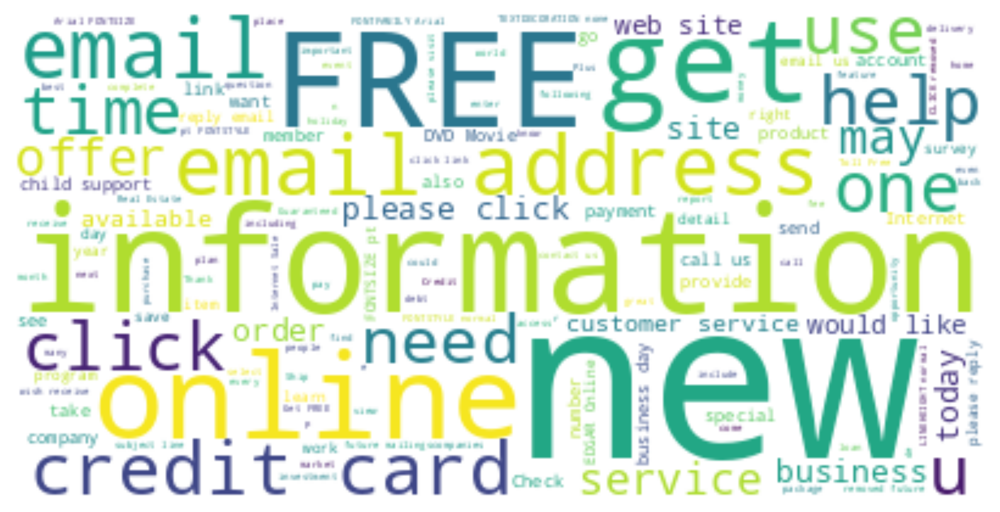

In [ ]:
# To use the 'wordcloud' library, you need to install it first.
# sing Python's package manager, pip.
# Open a command prompt or terminal and run the following command:
# pip install wordcloud
# Or conda install -c https://conda.anaconda.org/conda-forge wordcloud

# Import the wordcloud library
import warnings
import matplotlib.pyplot as plt
from wordcloud import WordCloud

warnings.simplefilter("ignore", DeprecationWarning)

# Join the different processed titles together.
string_fraud = ','.join(list(fraud_df['fraud_body'].values))

# Create a WordCloud object
wordcloud_fraud = WordCloud(background_color= "white",
                      max_words= 300,
                      contour_width= 15,
                      contour_color= 'steelblue',

                      # Specify the words to remove
                      stopwords={"IMAGE", "I MAKE", "MAKE"}
                     )

# Generate a word cloud
wordcloud_fraud.generate(string_fraud)

# Visualize the word cloud
wordcloud_fraud.to_image()

plt.figure(figsize= (10, 10), dpi= 1200)
plt.imshow(wordcloud_fraud, interpolation= "bilinear")
plt.axis("off")

plt.show()

#### Prepare text for LDA analysis

Next, let’s work to transform the textual data in a format that will serve as an input for training LDA model. We start by converting the documents into a simple vector representation (Bag of Words BOW). Next, we will convert a list of titles into lists of vectors, all with length equal to the vocabulary.

We’ll then plot the ten most frequent words based on the outcome of this operation (the list of document vectors). As a check, these words should also occur in the word cloud.

## LDA Modelling Analysis (Non Fraud)

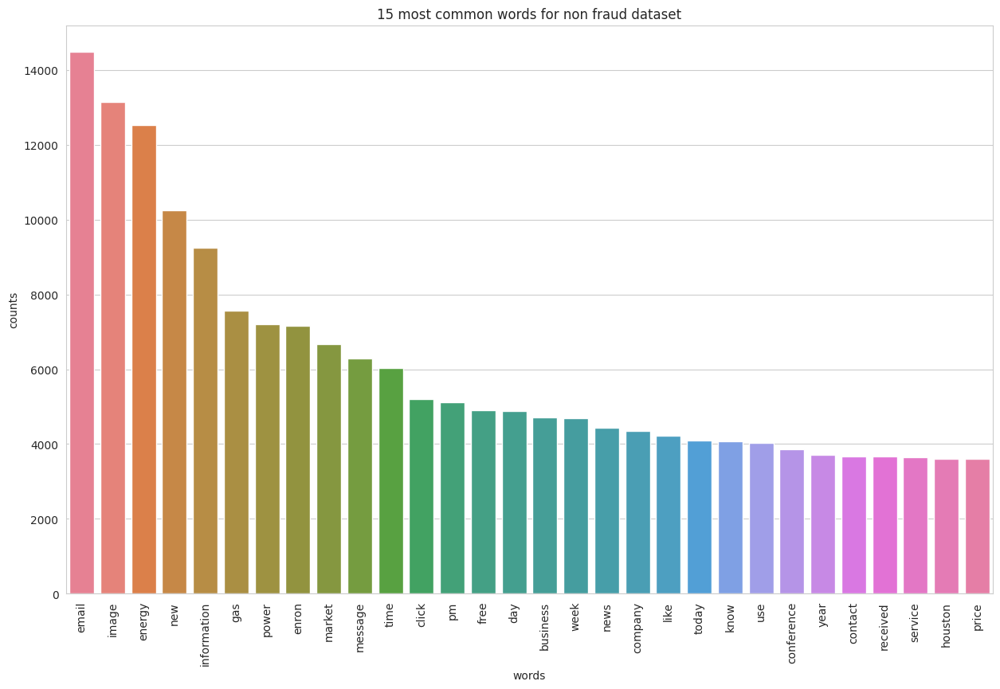

In [ ]:
# Load the library with the CountVectorizer method
from sklearn.feature_extraction.text import CountVectorizer
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
%matplotlib inline

import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

# Helper function
def plot_10_most_common_words(count_data_non_fraud, count_vectorizer_non_fraud):
    import matplotlib.pyplot as plt
    words = count_vectorizer_non_fraud.get_feature_names_out()
    total_counts = np.zeros(len(words))
    for t in count_data_non_fraud:
        total_counts+=t.toarray()[0]

    count_dict = (zip(words, total_counts))
    count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)[0:30]
    words = [w[0] for w in count_dict]
    counts = [w[1] for w in count_dict]
    x_pos = np.arange(len(words))

    plt.figure(2, figsize=(15, 15/1.6180))
    plt.subplot(title='15 most common words for non fraud dataset')
    sns.set_context("notebook", font_scale=1.25, rc={"lines.linewidth": 2.5})
    sns.barplot(x=x_pos, y=counts, palette='husl')
    plt.xticks(x_pos, words, rotation=90)
    plt.xlabel('words')
    plt.ylabel('counts')
    plt.show()

# Initialise the count vectorizer with the English stop words
count_vectorizer_non_fraud = CountVectorizer(stop_words='english')

# Fit and transform the processed titles
count_data_non_fraud = count_vectorizer_non_fraud.fit_transform(non_fraud_df['non_fraud_body'])

# Visualise the 10 most common words
plot_10_most_common_words(count_data_non_fraud, count_vectorizer_non_fraud)

## LDA Modelling Analysis (Non Fraud)

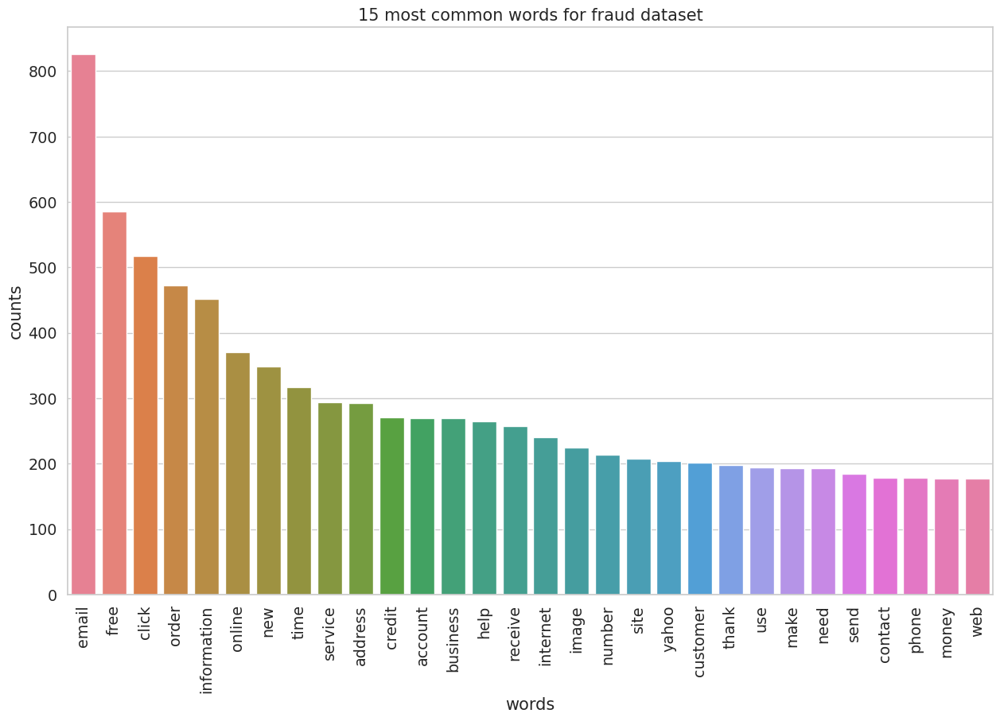

In [ ]:
# Load the library with the CountVectorizer method
from sklearn.feature_extraction.text import CountVectorizer
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')
%matplotlib inline

import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

# Helper function
def plot_10_most_common_words(count_data_fraud, count_vectorizer_fraud):
    import matplotlib.pyplot as plt
    words = count_vectorizer_fraud.get_feature_names_out()
    total_counts = np.zeros(len(words))
    for t in count_data_fraud:
        total_counts+=t.toarray()[0]

    count_dict = (zip(words, total_counts))
    count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)[0:30]
    words = [w[0] for w in count_dict]
    counts = [w[1] for w in count_dict]
    x_pos = np.arange(len(words))

    plt.figure(2, figsize=(15, 15/1.6180))
    plt.subplot(title='15 most common words for fraud dataset')
    sns.set_context("notebook", font_scale=1.25, rc={"lines.linewidth": 2.5})
    sns.barplot(x=x_pos, y=counts, palette='husl')
    plt.xticks(x_pos, words, rotation=90)
    plt.xlabel('words')
    plt.ylabel('counts')
    plt.show()

# Initialise the count vectorizer with the English stop words
count_vectorizer_fraud = CountVectorizer(stop_words='english')

# Fit and transform the processed titles
count_data_fraud = count_vectorizer_fraud.fit_transform(fraud_df['fraud_body'])

# Visualise the 10 most common words
plot_10_most_common_words(count_data_fraud, count_vectorizer_fraud)

## LDA model tranining (Non Fraud)

To keep things simple, we will only tweak the number of topic parameters.

In [ ]:
import warnings
warnings.simplefilter("ignore", DeprecationWarning)

# Load the LDA model from sk-learn
from sklearn.decomposition import LatentDirichletAllocation as LDA

# Helper function
def print_topics(model_non_fraud, count_vectorizer_non_fraud, n_top_words_non_fraud):
    words = count_vectorizer_non_fraud.get_feature_names_out()
    for topic_idx, topic in enumerate(model_non_fraud.components_):
        print("\nTopic #%d:" % topic_idx)
        print(" ".join([words[i]
                        for i in topic.argsort()[:-n_top_words_non_fraud - 1:-1]]))

# Tweak the two parameters below (use int values below 15)
number_topics = 12
number_words = 25

# Create and fit the LDA model
lda_non_fraud = LDA(n_components=number_topics)
lda_non_fraud.fit(count_data_non_fraud)

# Print the topics found by the LDA model
print("Topics found via LDA non fraud:")
print_topics(lda_non_fraud, count_vectorizer_non_fraud, number_words)

Topics found via LDA non fraud:

Topic #0:
enron know thanks vince let time email like forward hope work regards look best thank need pm houston john send make message week dear think

Topic #1:
image pm story oil news energy et price new houston click wine caracas venezuela club bureau petroleumworld live williams email oct showtimes change opec events

Topic #2:
energy new risk management conference business information email market technology industry company research markets group companies trading program contact th forward services financial options like

Topic #3:
network world new market buy eps today na company storage information email service newsletter price security shares linux software services management strong subscription product focus

Topic #4:
email information message order data intended thank enron address received fax use recipient copy number contact attached confidential phone delete sender questions time communication error

Topic #5:
gas energy power natural

## LDA model tranining (Fraud)

To keep things simple, we will only tweak the number of topic parameters.

In [ ]:
import warnings
warnings.simplefilter("ignore", DeprecationWarning)

# Load the LDA model from sk-learn
from sklearn.decomposition import LatentDirichletAllocation as LDA

# Helper function
def print_topics(model_fraud, count_vectorizer_fraud, n_top_words_fraud):
    words = count_vectorizer_fraud.get_feature_names_out()
    for topic_idx, topic in enumerate(model_fraud.components_):
        print("\nTopic #%d:" % topic_idx)
        print(" ".join([words[i]
                        for i in topic.argsort()[:-n_top_words_fraud - 1:-1]]))

# Tweak the two parameters below (use int values below 15)
number_topics = 8
number_words = 16

# Create and fit the LDA model
lda_fraud = LDA(n_components=number_topics)
lda_fraud.fit(count_data_fraud)

# Print the topics found by the LDA model
print("Topics found via LDA fraud:")
print_topics(lda_fraud, count_vectorizer_fraud, number_words)

Topics found via LDA fraud:

Topic #0:
email credit free address information order phone receive debt click business help money time card account

Topic #1:
normal order support child customer gift holiday arial color fontsize textdecoration time pt email fontstyle day

Topic #2:
dvd online free copy click wizard edgar site software movie service using movies web email password

Topic #3:
image free email information click receive secure financial id new aid time site account netellercom message

Topic #4:
information click free email message send save vacation password services new legal tv use rates descrambler

Topic #5:
order email business service new click shipment shipped items number use dear days windows help customer

Topic #6:
yahoo account email new etrade internet sales bank address cigar bancware information image online department free

Topic #7:
click free new family digital image service today subscription email tree special available time dear ameritrade


### Analyzing our LDA model (Non-Fraud)

Now that we have a trained model let’s visualize the topics for interpretability. To do so, we’ll use a popular visualization package, pyLDAvis which is designed to help interactively with:

1. Better understanding and interpreting individual topics, and
2. Better understanding the relationships between the topics.

For (1), you can manually select each topic to view its top most frequent and/or “relevant” terms, using different values of the λ parameter. This can help when you’re trying to assign a human interpretable name or “meaning” to each topic.
For (2), exploring the Intertopic Distance Plot can help you learn about how topics relate to each other, including potential higher-level structure between groups of topics.

Before runnnig code below, first you need to:
pip install pyLDAvis

And then perhaps: pip install --upgrade scikit-learn pyLDAvis

In [ ]:
%%time
import os
import warnings

with warnings.catch_warnings():
    warnings.filterwarnings("ignore", category=DeprecationWarning)

import pyLDAvis.lda_model
import pickle


# Visualize the topics
pyLDAvis.enable_notebook()

LDAvis_data_filepath_non_fraud = os.path.join('./ldavis_prepared_non_fraud_'+str(number_topics))
# # this is a bit time consuming - make the if statement True
# # if you want to execute visualization prep yourself
if 1 == 1:

    LDAvis_prepared_non_fraud = pyLDAvis.lda_model.prepare(lda_non_fraud, count_data_non_fraud, count_vectorizer_non_fraud)

    with open(LDAvis_data_filepath_non_fraud, 'wb') as f:
        pickle.dump(LDAvis_prepared_non_fraud, f)

# load the pre-prepared pyLDAvis data from disk
with open(LDAvis_data_filepath_non_fraud, 'rb') as f:
    LDAvis_prepared_non_fraud = pickle.load(f)

pyLDAvis.save_html(LDAvis_prepared_non_fraud, './ldavis_prepared_non_fraud_'+ str(number_topics) +'.html')

LDAvis_prepared_non_fraud

CPU times: user 6.37 s, sys: 2.49 s, total: 8.87 s
Wall time: 15.8 s


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
5      0.052134  0.157886       1        1  15.443196
2      0.052730  0.125481       2        1  15.403099
7      0.098129  0.019163       3        1  13.176305
10    -0.063260  0.162482       4        1  11.443616
1      0.135142  0.013422       5        1   6.965801
0     -0.032678 -0.109972       6        1   6.903953
3      0.073132  0.108580       7        1   6.604016
9      0.113362 -0.167350       8        1   5.937766
4     -0.137117  0.006531       9        1   5.167813
8      0.088304 -0.199886      10        1   5.133325
6     -0.324399 -0.041891      11        1   4.692805
11    -0.055478 -0.074445      12        1   3.128304, topic_info=              Term          Freq         Total Category  logprob  loglift
30558        image  12594.000000  12594.000000  Default  30.0000  30.0000
19785        email  13866.000000  13866.000000  Default  29.0000  29.0000
25490          gas   7298.000000   7298.000000  Default  28.0000  28.0000
50235           pm   4895.000000   4895.000000  Default  27.0000  27.0000
40828      message   5993.000000   5993.000000  Default  26.0000  26.0000
...            ...           ...           ...      ...      ...      ...
65413        texas    243.698685   1742.215246  Topic12  -5.6064   1.4977
65473           th    262.762223   3249.840381  Topic12  -5.5310   0.9496
31688  information    297.638653   8934.849411  Topic12  -5.4064   0.0628
4634     available    219.060968   3195.179827  Topic12  -5.7129   0.7846
20527        enron    221.710580   6890.975471  Topic12  -5.7009   0.0281

[990 rows x 6 columns], token_table=       Topic      Freq         Term
term                               
121        1  0.994188      abilene
310        3  0.986683  accessories
368        1  0.075831      account
368        2  0.036208      account
368        3  0.530817      account
...      ...       ...          ...
73182     12  0.013306         year
73420      9  0.015671          ypo
73420     12  0.976801          ypo
73424     12  0.981625       ypoers
73660      1  0.984139         ziff

[3768 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[6, 3, 8, 11, 2, 1, 4, 10, 5, 9, 7, 12])

### Analyzing our LDA model (Fraud)

Now that we have a trained model let’s visualize the topics for interpretability. To do so, we’ll use a popular visualization package, pyLDAvis which is designed to help interactively with:

1. Better understanding and interpreting individual topics, and
2. Better understanding the relationships between the topics.

For (1), you can manually select each topic to view its top most frequent and/or “relevant” terms, using different values of the λ parameter. This can help when you’re trying to assign a human interpretable name or “meaning” to each topic.
For (2), exploring the Intertopic Distance Plot can help you learn about how topics relate to each other, including potential higher-level structure between groups of topics.

Before runnnig code below, first you need to:
pip install pyLDAvis

And then perhaps: pip install --upgrade scikit-learn pyLDAvis

In [ ]:
%%time
import os
import warnings

with warnings.catch_warnings():
    warnings.filterwarnings("ignore", category=DeprecationWarning)

import pyLDAvis.lda_model
import pickle


# Visualize the topics
pyLDAvis.enable_notebook()

LDAvis_data_filepath_fraud = os.path.join('./ldavis_prepared_fraud_'+str(number_topics))
# # this is a bit time consuming - make the if statement True
# # if you want to execute visualization prep yourself
if 1 == 1:

    LDAvis_prepared_fraud = pyLDAvis.lda_model.prepare(lda_fraud, count_data_fraud, count_vectorizer_fraud)

    with open(LDAvis_data_filepath_fraud, 'wb') as f:
        pickle.dump(LDAvis_prepared_fraud, f)

# load the pre-prepared pyLDAvis data from disk
with open(LDAvis_data_filepath_fraud, 'rb') as f:
    LDAvis_prepared_fraud = pickle.load(f)

pyLDAvis.save_html(LDAvis_prepared_fraud, './ldavis_prepared_fraud_'+ str(number_topics) +'.html')

LDAvis_prepared_fraud

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


CPU times: user 421 ms, sys: 29.4 ms, total: 451 ms
Wall time: 2.24 s


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.015391 -0.031725       1        1  28.352573
1     -0.219779  0.056896       2        1  13.034508
5     -0.065038  0.050379       3        1  12.712405
2      0.035156 -0.161562       4        1  12.321461
4      0.017986 -0.042798       5        1  10.044105
3      0.056716 -0.011861       6        1   9.078773
6      0.150779  0.151507       7        1   8.854730
7      0.039572 -0.010836       8        1   5.601447, topic_info=         Term        Freq       Total Category  logprob  loglift
8315    yahoo  174.000000  174.000000  Default  30.0000  30.0000
2248      dvd  152.000000  152.000000  Default  29.0000  29.0000
5090   normal  126.000000  126.000000  Default  28.0000  28.0000
48    account  239.000000  239.000000  Default  27.0000  27.0000
3634    image  193.000000  193.000000  Default  26.0000  26.0000
...       ...         ...         ...      ...      ...      ...
48    account   12.244973  239.492783   Topic8  -5.7023  -0.0913
5497  payment   10.763104   94.894433   Topic8  -5.8313   0.7055
6294   remove   10.791711  126.991363   Topic8  -5.8286   0.4168
5190    offer   10.770969  155.413751   Topic8  -5.8306   0.2129
5249   online   10.641538  330.769879   Topic8  -5.8427  -0.5545

[563 rows x 6 columns], token_table=      Topic      Freq                Term
term                                     
16        2  0.950862              absent
27        1  0.840337              accept
27        3  0.048019              accept
27        6  0.072029              accept
27        8  0.048019              accept
...     ...       ...                 ...
8326      3  0.078028                 yes
8326      5  0.585213                 yes
8326      8  0.039014                 yes
8359      3  0.989920       zanybrainycom
8360      3  0.877644  zanybrainycomwhere

[1222 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 2, 6, 3, 5, 4, 7, 8])

### Closing Notes
Machine learning has become increasingly popular over the past decade, and recent advances in computational availability have led to exponential growth to people looking for ways how new methods can be incorporated to advance the field of Natural Language Processing.

Often, we treat topic models as black-box algorithms, but hopefully, this post addressed to shed light on the underlying math, and intuitions behind it, and high-level code to get you started with any textual data.

In the next article, we’ll go one step deeper into understanding how you can evaluate the performance of topic models, tune its hyper-parameters to get more intuitive and reliable results.

** **
#### Sources:
1. Topic model — Wikipedia. https://en.wikipedia.org/wiki/Topic_model
2. Distributed Strategies for Topic Modeling. https://www.ideals.illinois.edu/bitstream/handle/2142/46405/ParallelTopicModels.pdf?sequence=2&isAllowed=y
3. Topic Mapping — Software — Resources — Amaral Lab. https://amaral.northwestern.edu/resources/software/topic-mapping
4. A Survey of Topic Modeling in Text Mining. https://thesai.org/Downloads/Volume6No1/Paper_21-A_Survey_of_Topic_Modeling_in_Text_Mining.pdf


In [ ]:
LDAvis_prepared_non_fraud

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
5      0.052134  0.157886       1        1  15.443196
2      0.052730  0.125481       2        1  15.403099
7      0.098129  0.019163       3        1  13.176305
10    -0.063260  0.162482       4        1  11.443616
1      0.135142  0.013422       5        1   6.965801
0     -0.032678 -0.109972       6        1   6.903953
3      0.073132  0.108580       7        1   6.604016
9      0.113362 -0.167350       8        1   5.937766
4     -0.137117  0.006531       9        1   5.167813
8      0.088304 -0.199886      10        1   5.133325
6     -0.324399 -0.041891      11        1   4.692805
11    -0.055478 -0.074445      12        1   3.128304, topic_info=              Term          Freq         Total Category  logprob  loglift
30558        image  12594.000000  12594.000000  Default  30.0000  30.0000
19785        email  13866.000000  13866.000000  Default  29.0000  29.0000
25490          gas   7298.000000   7298.000000  Default  28.0000  28.0000
50235           pm   4895.000000   4895.000000  Default  27.0000  27.0000
40828      message   5993.000000   5993.000000  Default  26.0000  26.0000
...            ...           ...           ...      ...      ...      ...
65413        texas    243.698685   1742.215246  Topic12  -5.6064   1.4977
65473           th    262.762223   3249.840381  Topic12  -5.5310   0.9496
31688  information    297.638653   8934.849411  Topic12  -5.4064   0.0628
4634     available    219.060968   3195.179827  Topic12  -5.7129   0.7846
20527        enron    221.710580   6890.975471  Topic12  -5.7009   0.0281

[990 rows x 6 columns], token_table=       Topic      Freq         Term
term                               
121        1  0.994188      abilene
310        3  0.986683  accessories
368        1  0.075831      account
368        2  0.036208      account
368        3  0.530817      account
...      ...       ...          ...
73182     12  0.013306         year
73420      9  0.015671          ypo
73420     12  0.976801          ypo
73424     12  0.981625       ypoers
73660      1  0.984139         ziff

[3768 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[6, 3, 8, 11, 2, 1, 4, 10, 5, 9, 7, 12])

In [ ]:
LDAvis_prepared_fraud

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.015391 -0.031725       1        1  28.352573
1     -0.219779  0.056896       2        1  13.034508
5     -0.065038  0.050379       3        1  12.712405
2      0.035156 -0.161562       4        1  12.321461
4      0.017986 -0.042798       5        1  10.044105
3      0.056716 -0.011861       6        1   9.078773
6      0.150779  0.151507       7        1   8.854730
7      0.039572 -0.010836       8        1   5.601447, topic_info=         Term        Freq       Total Category  logprob  loglift
8315    yahoo  174.000000  174.000000  Default  30.0000  30.0000
2248      dvd  152.000000  152.000000  Default  29.0000  29.0000
5090   normal  126.000000  126.000000  Default  28.0000  28.0000
48    account  239.000000  239.000000  Default  27.0000  27.0000
3634    image  193.000000  193.000000  Default  26.0000  26.0000
...       ...         ...         ...      ...      ...      ...
48    account   12.244973  239.492783   Topic8  -5.7023  -0.0913
5497  payment   10.763104   94.894433   Topic8  -5.8313   0.7055
6294   remove   10.791711  126.991363   Topic8  -5.8286   0.4168
5190    offer   10.770969  155.413751   Topic8  -5.8306   0.2129
5249   online   10.641538  330.769879   Topic8  -5.8427  -0.5545

[563 rows x 6 columns], token_table=      Topic      Freq                Term
term                                     
16        2  0.950862              absent
27        1  0.840337              accept
27        3  0.048019              accept
27        6  0.072029              accept
27        8  0.048019              accept
...     ...       ...                 ...
8326      3  0.078028                 yes
8326      5  0.585213                 yes
8326      8  0.039014                 yes
8359      3  0.989920       zanybrainycom
8360      3  0.877644  zanybrainycomwhere

[1222 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 2, 6, 3, 5, 4, 7, 8])